In [98]:
import math
import uuid
from operator import itemgetter

import gmdhpy.gmdh
import numpy as np
import pandas as pd
from io import StringIO
import graphviz
import pydotplus
from typing import Dict, Tuple

from dython.nominal import associations
from scipy import stats
from sklearn.neural_network._multilayer_perceptron import MLPClassifier
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier, StackingClassifier
from sklearn.model_selection import train_test_split, validation_curve
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from sklearn.metrics._classification import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.linear_model import SGDClassifier
from sklearn.metrics import confusion_matrix, plot_confusion_matrix, ConfusionMatrixDisplay
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.svm import SVC, NuSVC, LinearSVC
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor, export_graphviz
from sklearn.model_selection import GridSearchCV
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, StandardScaler
from sklearn.preprocessing import LabelEncoder
from IPython.core.display import HTML, Image
from sklearn.tree import export_text, export_graphviz
import graphviz
from xgboost import XGBClassifier
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
sns.set(style="ticks")

# Загрузка и преобразование данных

In [28]:
data = pd.read_csv("datasets/Hotel Reservations.csv")

In [29]:
data.shape

(36275, 19)

In [30]:
data.head()

,Booking_ID,no_of_adults,no_of_children,no_of_weekend_nights,no_of_week_nights,type_of_meal_plan,required_car_parking_space,room_type_reserved,lead_time,arrival_year,arrival_month,arrival_date,market_segment_type,repeated_guest,no_of_previous_cancellations,no_of_previous_bookings_not_canceled,avg_price_per_room,no_of_special_requests,booking_status
0,INN00001,2,0,1,2,Meal Plan 1,0,Room_Type 1,224,2017,10,2,Offline,0,0,0,65.00,0,Not_Canceled
1,INN00002,2,0,2,3,Not Selected,0,Room_Type 1,5,2018,11,6,Online,0,0,0,106.68,1,Not_Canceled
2,INN00003,1,0,2,1,Meal Plan 1,0,Room_Type 1,1,2018,2,28,Online,0,0,0,60.00,0,Canceled
3,INN00004,2,0,0,2,Meal Plan 1,0,Room_Type 1,211,2018,5,20,Online,0,0,0,100.00,0,Canceled
4,INN00005,2,0,1,1,Not Selected,0,Room_Type 1,48,2018,4,11,Online,0,0,0,94.50,0,Canceled


In [31]:
# Удаляем ненужные колонки
cols_to_drop = [
    "Booking_ID",
]
data.drop(cols_to_drop, axis=1, inplace=True)

In [32]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36275 entries, 0 to 36274
Data columns (total 18 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   no_of_adults                          36275 non-null  int64  
 1   no_of_children                        36275 non-null  int64  
 2   no_of_weekend_nights                  36275 non-null  int64  
 3   no_of_week_nights                     36275 non-null  int64  
 4   type_of_meal_plan                     36275 non-null  object 
 5   required_car_parking_space            36275 non-null  int64  
 6   room_type_reserved                    36275 non-null  object 
 7   lead_time                             36275 non-null  int64  
 8   arrival_year                          36275 non-null  int64  
 9   arrival_month                         36275 non-null  int64  
 10  arrival_date                          36275 non-null  int64  
 11  market_segment_

In [33]:
data.isnull().sum()

no_of_adults                            0
no_of_children                          0
no_of_weekend_nights                    0
no_of_week_nights                       0
type_of_meal_plan                       0
required_car_parking_space              0
room_type_reserved                      0
lead_time                               0
arrival_year                            0
arrival_month                           0
arrival_date                            0
market_segment_type                     0
repeated_guest                          0
no_of_previous_cancellations            0
no_of_previous_bookings_not_canceled    0
avg_price_per_room                      0
no_of_special_requests                  0
booking_status                          0
dtype: int64

In [34]:
# Получаем метки категориальных признаков
cat_features = []
for col in data.columns:
    dt = str(data[col].dtype)
    if dt == "object":
        cat_features.append(col)
cat_features

['type_of_meal_plan',
 'room_type_reserved',
 'market_segment_type',
 'booking_status']

In [35]:
# Функция построения полной матрицы корреляции
def plot_full_corr_matrix(dataset_, nominal_columns_):
    res_corr = associations(
        dataset=dataset_,
        nominal_columns=nominal_columns_,
        cmap=sns.diverging_palette(220, 20, as_cmap=True),
        title='Полная матрица корреляции',
        clustering=True,
        figsize=(18,18),
        plot=False,
        compute_only=True,
        mark_columns=True,
    )
    corr_matrix = res_corr['corr']
    plt.figure(figsize=(24,16))
    sns.heatmap(
        data=corr_matrix,
        square=True,
        center=0,
        cmap=sns.diverging_palette(220, 20, as_cmap=True),
        annot=True,
        vmin=-1.0,
        vmax=1.0
    )
    plt.show()

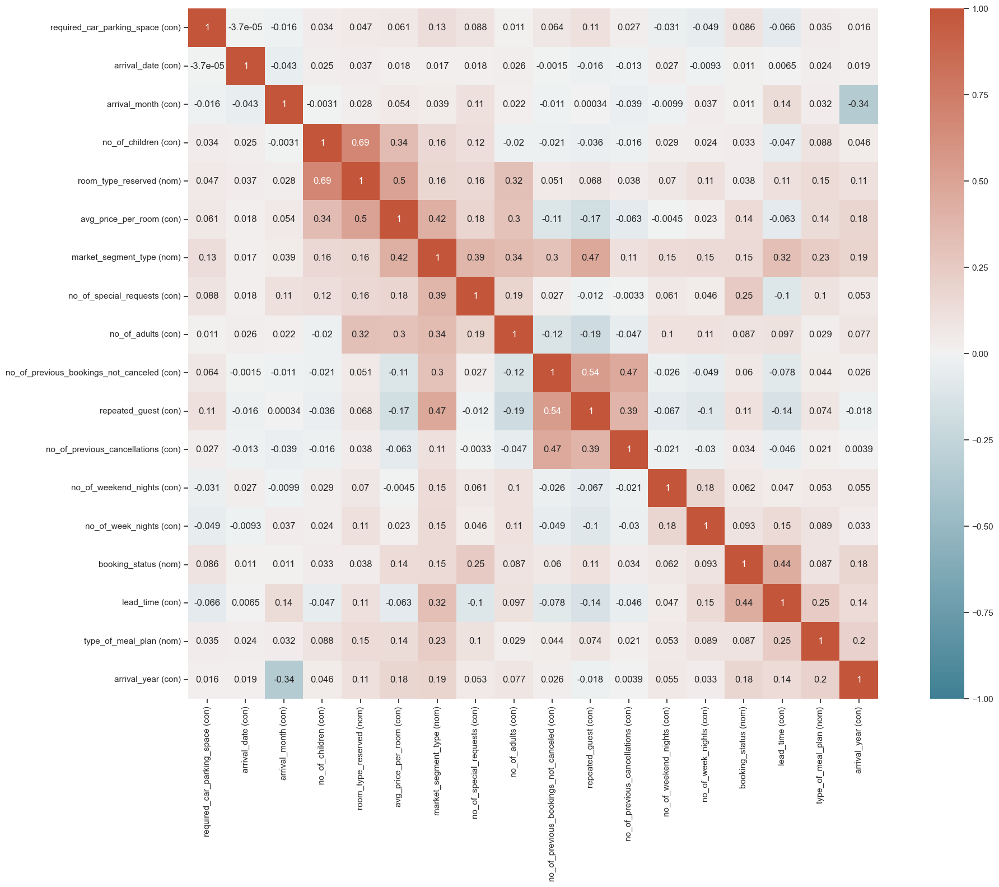

In [36]:
plot_full_corr_matrix(dataset_=data, nominal_columns_=cat_features)

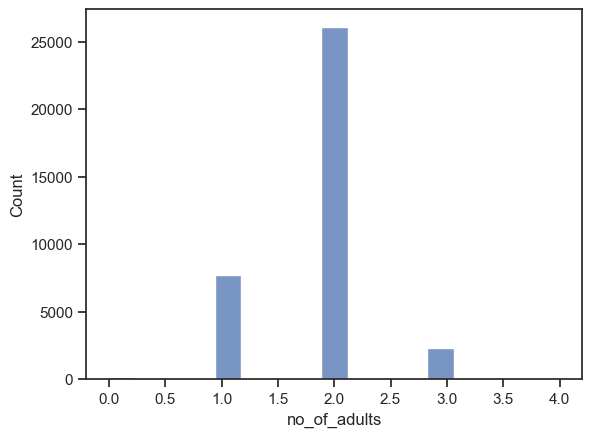

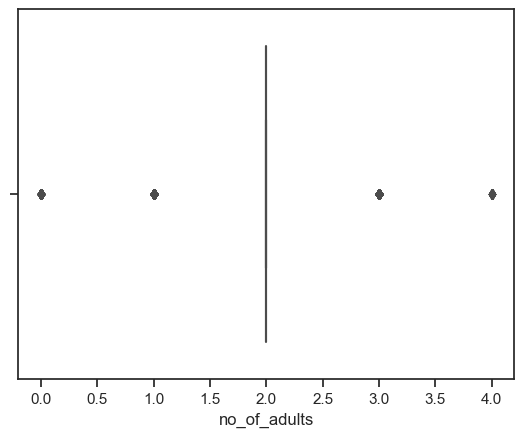

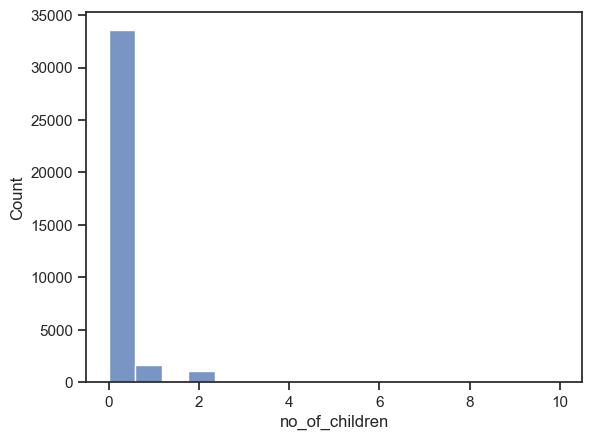

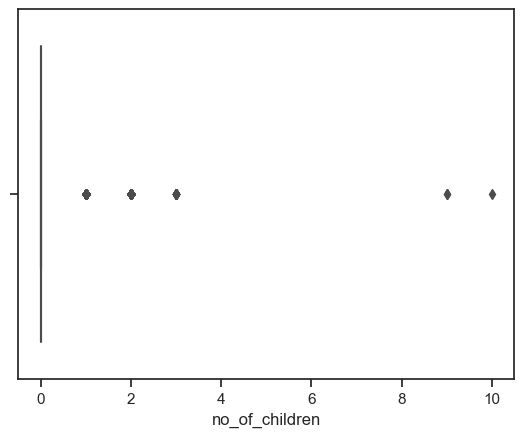

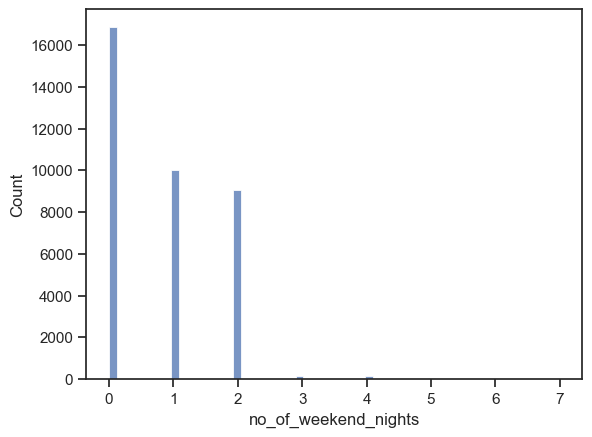

...

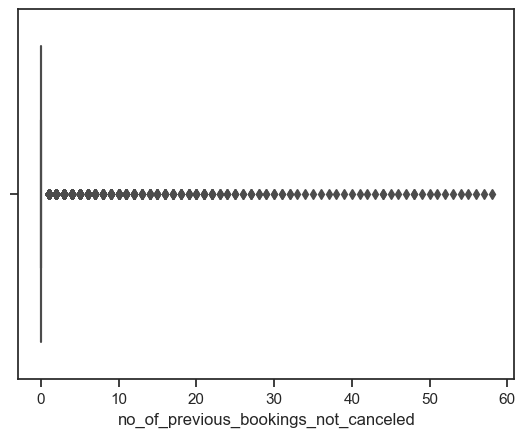

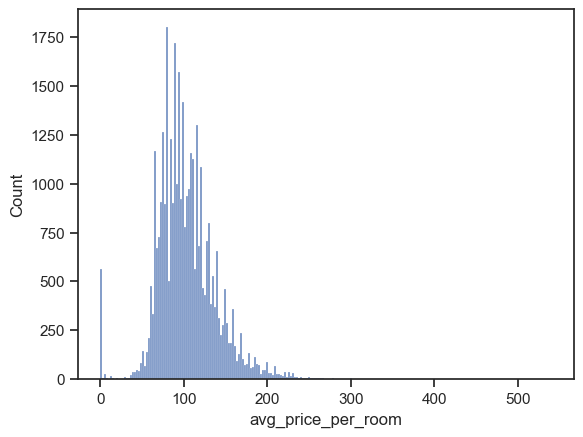

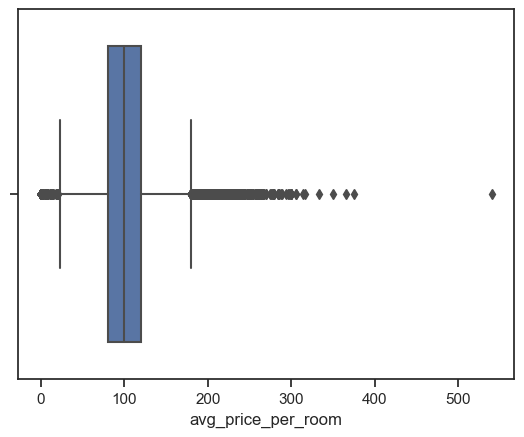

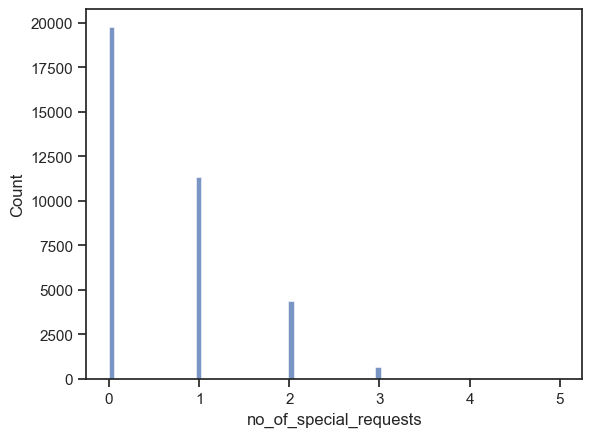

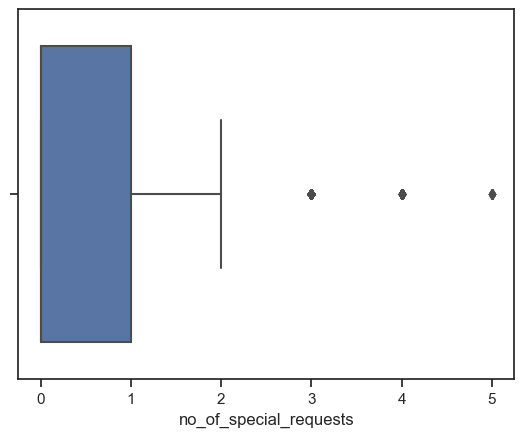

In [37]:
for col in data.drop(cat_features, axis=1, inplace=False):
    sns.histplot(data=data, x=col)
    plt.show()
    sns.boxplot(data=data, x=col)
    plt.show()

In [38]:
# Выбросы
def remove_outliers(df, label):
    q1 = df[label].quantile(0.25)
    q3 = df[label].quantile(0.75)
    iqr = (q3 - q1)
    fil = (df[label] >= q1 - 1.5 * iqr) & (df[label] <= q3 + 1.5 * iqr)
    return df.loc[fil]

In [39]:
col_to_remove_outliers_in = [
    "avg_price_per_room",
    "lead_time"
]

for col in col_to_remove_outliers_in:
    data = remove_outliers(data, col)

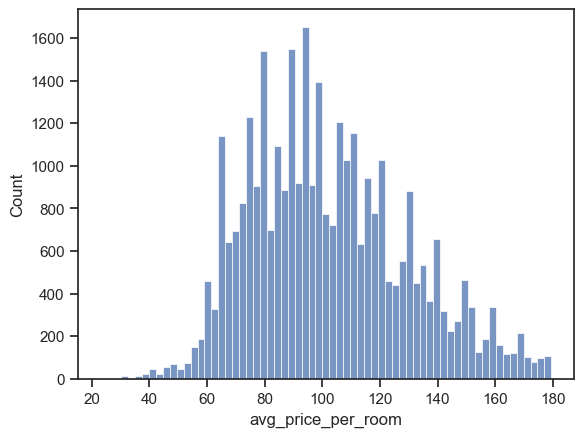

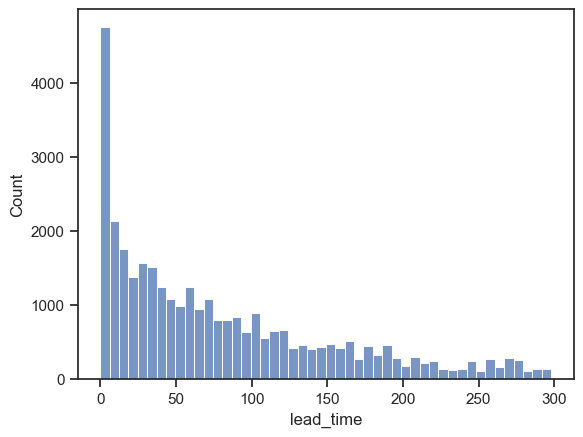

In [40]:
for col in col_to_remove_outliers_in:
    sns.histplot(data=data, x=col)
    plt.show()

In [41]:
# Кодирование признаков
data["booking_status"] = LabelEncoder().fit_transform(data["booking_status"])
cat_features.remove("booking_status")
data = pd.get_dummies(data=data, columns=cat_features)

In [42]:
# Итоговый набор данных
data

,no_of_adults,no_of_children,no_of_weekend_nights,no_of_week_nights,required_car_parking_space,lead_time,arrival_year,arrival_month,arrival_date,repeated_guest,...,room_type_reserved_Room_Type 3,room_type_reserved_Room_Type 4,room_type_reserved_Room_Type 5,room_type_reserved_Room_Type 6,room_type_reserved_Room_Type 7,market_segment_type_Aviation,market_segment_type_Complementary,market_segment_type_Corporate,market_segment_type_Offline,market_segment_type_Online
0,2,0,1,2,0,224,2017,10,2,0,...,0,0,0,0,0,0,0,0,1,0
1,2,0,2,3,0,5,2018,11,6,0,...,0,0,0,0,0,0,0,0,0,1
2,1,0,2,1,0,1,2018,2,28,0,...,0,0,0,0,0,0,0,0,0,1
3,2,0,0,2,0,211,2018,5,20,0,...,0,0,0,0,0,0,0,0,0,1
4,2,0,1,1,0,48,2018,4,11,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36270,3,0,2,6,0,85,2018,8,3,0,...,0,1,0,0,0,0,0,0,0,1
36271,2,0,1,3,0,228,2018,10,17,0,...,0,0,0,0,0,0,0,0,0,1
36272,2,0,2,6,0,148,2018,7,1,0,...,0,0,0,0,0,0,0,0,0,1
36273,2,0,0,3,0,63,2018,4,21,0,...,0,0,0,0,0,0,0,0,0,1


In [43]:
# Визуализация дерева
def get_png_tree(tree_model_param, feature_names_param):
    dot_data = StringIO()
    export_graphviz(tree_model_param, out_file=dot_data, feature_names=feature_names_param,
                    filled=True, rounded=True, special_characters=True)
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    return graph.create_png()

In [52]:
def plot_validation_curve(estimator, title, X, y,
                          param_name, param_range, cv,
                          scoring='accuracy'):

    train_scores, test_scores = validation_curve(
        estimator, X, y, param_name=param_name, param_range=param_range,
        cv=cv, scoring=scoring, n_jobs=1)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.title(title)
    plt.xlabel(param_name)
    plt.ylabel(str(scoring))
    plt.ylim(0.8, 1.05)
    lw = 2
    plt.plot(param_range, train_scores_mean, label="Training score",
                 color="darkorange", lw=lw)
    plt.fill_between(param_range, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.4,
                     color="darkorange", lw=lw)
    plt.plot(param_range, test_scores_mean, label="Cross-validation score",
                 color="navy", lw=lw)
    plt.fill_between(param_range, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.2,
                     color="navy", lw=lw)
    plt.legend(loc="best")
    return plt

In [45]:
# Разбиение на матрицу объекты-признаки и целевой признак (таргет)
X = data.drop("booking_status", axis=1).values
y = data["booking_status"].values
X, y

(array([[2., 0., 1., ..., 0., 1., 0.],
        [2., 0., 2., ..., 0., 0., 1.],
        [1., 0., 2., ..., 0., 0., 1.],
        ...,
        [2., 0., 2., ..., 0., 0., 1.],
        [2., 0., 0., ..., 0., 0., 1.],
        [2., 0., 1., ..., 0., 1., 0.]]),
 array([1, 1, 0, ..., 1, 0, 1]))

In [46]:
# Формирование обучающей и тестовой выборки
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1, random_state = 9)

<module 'matplotlib.pyplot' from 'D:\\JetBrains\\PyCharm 2021.2.2\\PycharmProjects\\oad\\LR10\\.venv\\lib\\site-packages\\matplotlib\\pyplot.py'>

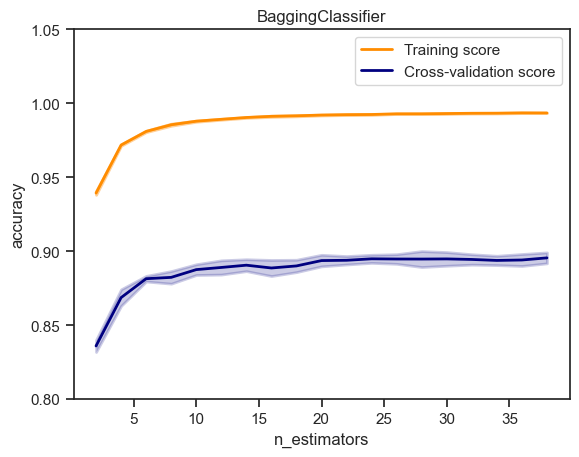

In [53]:
plot_validation_curve(BaggingClassifier(), 'BaggingClassifier',
                      X_train, y_train,
                      param_name='n_estimators', param_range=range(2, 40, 2),
                      cv=10, scoring="accuracy")

<module 'matplotlib.pyplot' from 'D:\\JetBrains\\PyCharm 2021.2.2\\PycharmProjects\\oad\\LR10\\.venv\\lib\\site-packages\\matplotlib\\pyplot.py'>

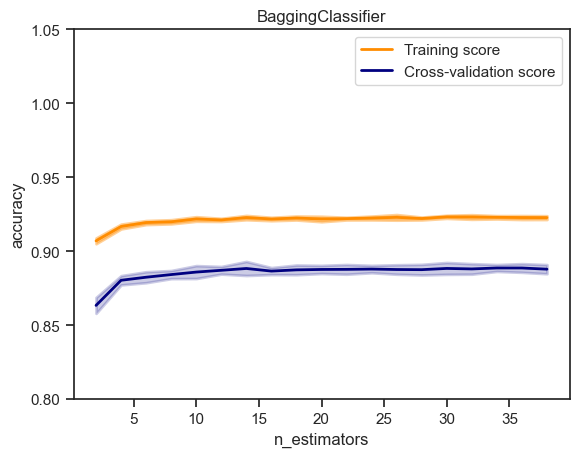

In [54]:
plot_validation_curve(BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=13)), 'BaggingClassifier',
                      X_train, y_train,
                      param_name='n_estimators', param_range=range(2, 40, 2),
                      cv=10, scoring="accuracy")

In [55]:
# Обучим классификатор на 10 деревьях
bc1 = BaggingClassifier(
    base_estimator=DecisionTreeClassifier(),
    n_estimators=10,
    oob_score=True,
    random_state=9,
)
bc1.fit(X_train, y_train)

y_train_predicted = bc1.predict(X_train)
y_test_predicted = bc1.predict(X_test)
print(classification_report(y_train, y_train_predicted), classification_report(y_test, y_test_predicted))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      9489
           1       0.99      0.99      0.99     20626

    accuracy                           0.99     30115
   macro avg       0.99      0.99      0.99     30115
weighted avg       0.99      0.99      0.99     30115
               precision    recall  f1-score   support

           0       0.82      0.82      0.82      1061
           1       0.92      0.92      0.92      2286

    accuracy                           0.89      3347
   macro avg       0.87      0.87      0.87      3347
weighted avg       0.89      0.89      0.89      3347



D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_bagging.py:747: UserWarning: Some inputs do not have OOB scores. This probably means too few estimators were used to compute any reliable oob estimates.
  warn(
D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_bagging.py:753: RuntimeWarning: invalid value encountered in divide
  oob_decision_function = predictions / predictions.sum(axis=1)[:, np.newaxis]


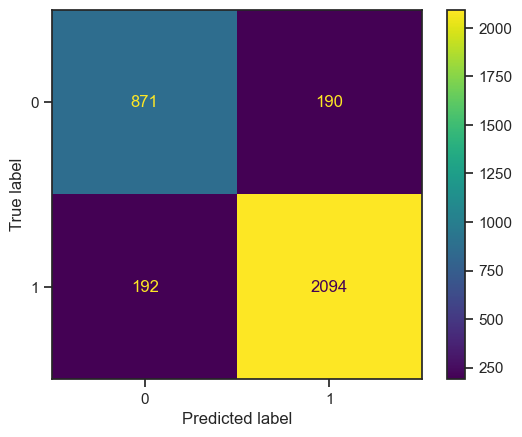

In [56]:
cm_log_bag = confusion_matrix(y_test, y_test_predicted, labels = bc1.classes_)
display_ = ConfusionMatrixDisplay(
    confusion_matrix=cm_log_bag
)
display_.plot()

In [57]:
bin_array = np.zeros((5, X_train.shape[0]))
for i in range(5):
    for j in bc1.estimators_samples_[i]:
        bin_array[i][j] = 1
bin_array

array([[1., 1., 0., ..., 1., 0., 1.],
       [0., 1., 0., ..., 1., 0., 1.],
       [1., 1., 0., ..., 0., 0., 1.],
       [1., 1., 0., ..., 0., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

In [58]:
# Оценим Out-of-bag error, теоретическое значение 37%
for i in range(5):
    cur_data = bin_array[i]
    len_cur_data = len(cur_data)
    sum_cur_data = sum(cur_data)
    (len(bin_array[0]) - sum(bin_array[0])) / len(bin_array[0])
    oob_i = (len_cur_data - sum_cur_data) / len_cur_data
    print('Для модели № {} размер OOB составляет {}%'.format(i+1, round(oob_i, 4)*100.0))

Для модели № 1 размер OOB составляет 36.9%
Для модели № 2 размер OOB составляет 36.88%
Для модели № 3 размер OOB составляет 36.51%
Для модели № 4 размер OOB составляет 36.34%
Для модели № 5 размер OOB составляет 36.730000000000004%


In [59]:
# Out-of-bag error, возвращаемый классификатором
# Для классификации используется метрика accuracy
bc1.oob_score_, 1-bc1.oob_score_

(0.8655487298688361, 0.13445127013116387)

In [60]:
# Вероятность принадлежности классам
# Можем анализировать, где не уверены
bc1.oob_decision_function_

array([[0.        , 1.        ],
       [0.33333333, 0.66666667],
       [0.        , 1.        ],
       ...,
       [0.4       , 0.6       ],
       [1.        , 0.        ],
       [0.        , 1.        ]])

In [61]:
column_labels = data.drop("booking_status", axis=1).columns

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.265266 to fit



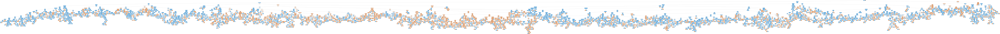

In [62]:
# Визуализация обученных решающих деревьев
Image(get_png_tree(bc1.estimators_[0], column_labels))

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.256122 to fit



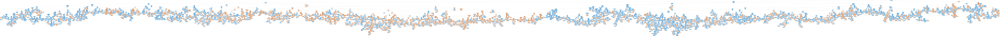

In [63]:
Image(get_png_tree(bc1.estimators_[1], column_labels))

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.251479 to fit



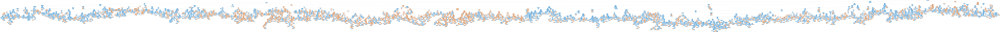

In [64]:
Image(get_png_tree(bc1.estimators_[2], column_labels))

# Случайный лес

In [65]:
# Обучим классификатор на 10 деревьях
forest = RandomForestClassifier(
    n_estimators=10,
    oob_score=True,
    random_state=9,
)
forest.fit(X_train, y_train)

y_train_predicted = forest.predict(X_train)
y_test_predicted = forest.predict(X_test)
print(classification_report(y_train, y_train_predicted), classification_report(y_test, y_test_predicted))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      9489
           1       0.99      0.99      0.99     20626

    accuracy                           0.99     30115
   macro avg       0.99      0.99      0.99     30115
weighted avg       0.99      0.99      0.99     30115
               precision    recall  f1-score   support

           0       0.84      0.82      0.83      1061
           1       0.92      0.93      0.92      2286

    accuracy                           0.89      3347
   macro avg       0.88      0.87      0.88      3347
weighted avg       0.89      0.89      0.89      3347



D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


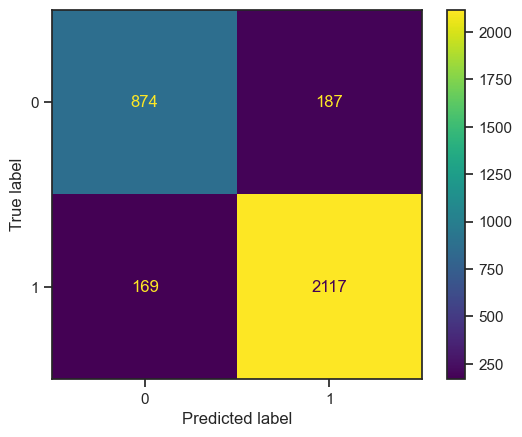

In [66]:
cm_log_forest = confusion_matrix(y_test, y_test_predicted, labels = forest.classes_)
display_ = ConfusionMatrixDisplay(
    confusion_matrix=cm_log_forest
)
display_.plot()

In [67]:
# Out-of-bag error, возвращаемый классификатором
forest.oob_score_, 1-forest.oob_score_

(0.8636891914328407, 0.13631080856715927)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.165195 to fit



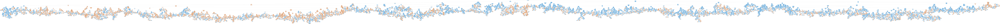

In [68]:
# Визуализация обученных решающих деревьев
Image(get_png_tree(forest.estimators_[0], column_labels))

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.171695 to fit



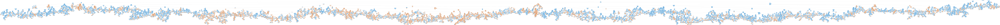

In [69]:
Image(get_png_tree(forest.estimators_[1], column_labels))

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.160038 to fit



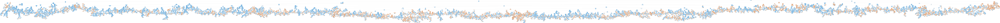

In [70]:
Image(get_png_tree(forest.estimators_[2], column_labels))

# XGBoost

<module 'matplotlib.pyplot' from 'D:\\JetBrains\\PyCharm 2021.2.2\\PycharmProjects\\oad\\LR10\\.venv\\lib\\site-packages\\matplotlib\\pyplot.py'>

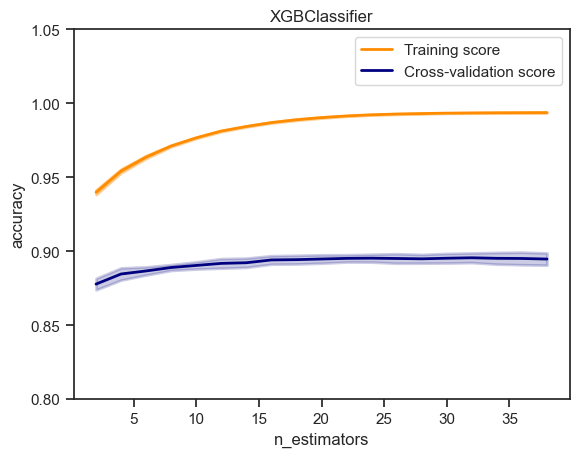

In [81]:
plot_validation_curve(
    XGBClassifier(
        max_depth=30,
        learning_rate=0.3,
        objective='binary:logistic',
    ),
    'XGBClassifier',
    X_train, y_train,
    param_name='n_estimators', param_range=range(2, 40, 2),
    cv=10, scoring="accuracy"
)

In [82]:
gbtree = XGBClassifier(
    n_estimators=20,
    max_depth=30,
    learning_rate=0.3,
    objective='binary:logistic',
    random_state=9
)
gbtree.fit(X_train, y_train)

y_train_predicted = gbtree.predict(X_train)
y_test_predicted = gbtree.predict(X_test)
print(classification_report(y_train, y_train_predicted), classification_report(y_test, y_test_predicted))

              precision    recall  f1-score   support

           0       0.99      0.98      0.98      9489
           1       0.99      1.00      0.99     20626

    accuracy                           0.99     30115
   macro avg       0.99      0.99      0.99     30115
weighted avg       0.99      0.99      0.99     30115
               precision    recall  f1-score   support

           0       0.85      0.80      0.82      1061
           1       0.91      0.93      0.92      2286

    accuracy                           0.89      3347
   macro avg       0.88      0.87      0.87      3347
weighted avg       0.89      0.89      0.89      3347



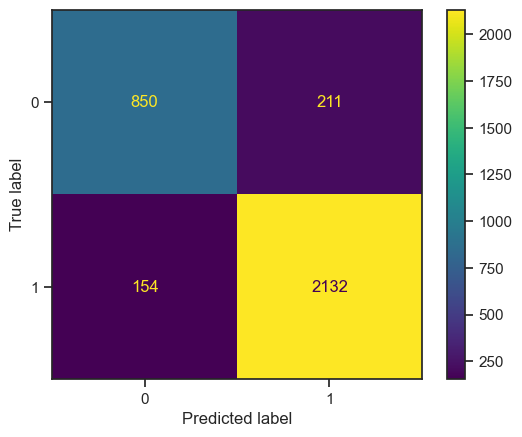

In [83]:
cm_log_gbtree = confusion_matrix(y_test, y_test_predicted, labels = gbtree.classes_)
display_ = ConfusionMatrixDisplay(
    confusion_matrix=cm_log_gbtree
)
display_.plot()

# Стэкинг

In [93]:
# Модели первого уровня
lr_clf = LogisticRegression(max_iter=10000)
dt_clf = DecisionTreeClassifier(random_state=9, max_depth=13)
rf_clf = forest

# Настаканные модели
stk1 = StackingClassifier(estimators=[('lr', lr_clf), ('dt', dt_clf)], final_estimator=dt_clf)
stk2 = StackingClassifier(estimators=[('lr', lr_clf), ('rf', rf_clf)], final_estimator=lr_clf)
stk3 = StackingClassifier(estimators=[('dt', dt_clf), ('rf', rf_clf)], final_estimator=lr_clf)

In [94]:
# Стэк #1
for clf, label in zip([lr_clf, dt_clf, stk1], ['LogisticRegression', 'DecisionTreeClassifier', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    if label == "Stacking":
        print(classification_report(y_test, y_stack_predict))
    else:
        print(f"Accuracy score: {accuracy_score(y_test, y_stack_predict)} {label}")

Accuracy score: 0.7872721840454138 LogisticRegression
Accuracy score: 0.8709291903196893 DecisionTreeClassifier
              precision    recall  f1-score   support

           0       0.78      0.74      0.76      1061
           1       0.88      0.90      0.89      2286

    accuracy                           0.85      3347
   macro avg       0.83      0.82      0.83      3347
weighted avg       0.85      0.85      0.85      3347



In [95]:
# Стэк #2
for clf, label in zip([lr_clf, rf_clf, stk2], ['LogisticRegression', 'RandomForestClassifier', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    if label == "Stacking":
        print(classification_report(y_test, y_stack_predict))
    else:
        print(f"Accuracy score: {accuracy_score(y_test, y_stack_predict)} {label}")

Accuracy score: 0.7872721840454138 LogisticRegression


D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


Accuracy score: 0.8936360920227069 RandomForestClassifier


D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.


              precision    recall  f1-score   support

           0       0.86      0.79      0.82      1061
           1       0.91      0.94      0.92      2286

    accuracy                           0.89      3347
   macro avg       0.88      0.86      0.87      3347
weighted avg       0.89      0.89      0.89      3347



D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


In [96]:
# Стэк #3
for clf, label in zip([dt_clf, rf_clf, stk3], ['DecisionTreeClassifier', 'RandomForestClassifier', 'Stacking']):
    clf.fit(X_train, y_train)
    y_stack_predict = clf.predict(X_test)
    if label == "Stacking":
        print(classification_report(y_test, y_stack_predict))
    else:
        print(f"Accuracy score: {accuracy_score(y_test, y_stack_predict)} {label}")

Accuracy score: 0.8709291903196893 DecisionTreeClassifier


D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


Accuracy score: 0.8936360920227069 RandomForestClassifier


D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.


              precision    recall  f1-score   support

           0       0.85      0.80      0.83      1061
           1       0.91      0.94      0.92      2286

    accuracy                           0.89      3347
   macro avg       0.88      0.87      0.88      3347
weighted avg       0.89      0.89      0.89      3347



D:\JetBrains\PyCharm 2021.2.2\PycharmProjects\oad\LR10\.venv\lib\site-packages\sklearn\ensemble\_forest.py:586: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(


# Многослойный персептрон

In [102]:
ml_perc = MLPClassifier(
    activation="logistic",
    max_iter=10000,
    shuffle=True,
    random_state=9,
)
ml_perc.fit(X_train, y_train)

y_train_predicted = ml_perc.predict(X_train)
y_test_predicted = ml_perc.predict(X_test)
print(classification_report(y_train, y_train_predicted), classification_report(y_test, y_test_predicted))

              precision    recall  f1-score   support

           0       0.78      0.63      0.70      9489
           1       0.84      0.92      0.88     20626

    accuracy                           0.83     30115
   macro avg       0.81      0.77      0.79     30115
weighted avg       0.82      0.83      0.82     30115
               precision    recall  f1-score   support

           0       0.76      0.63      0.68      1061
           1       0.84      0.91      0.87      2286

    accuracy                           0.82      3347
   macro avg       0.80      0.77      0.78      3347
weighted avg       0.81      0.82      0.81      3347



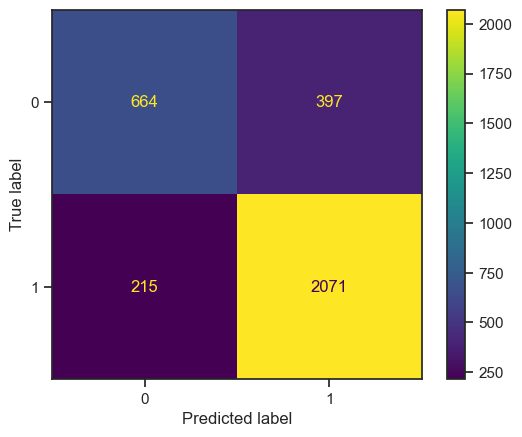

In [103]:
cm_log_perc = confusion_matrix(y_test, y_test_predicted, labels=ml_perc.classes_)
display_ = ConfusionMatrixDisplay(
    confusion_matrix=cm_log_perc
)
display_.plot()

# МГУА

In [124]:
from gmdhpy.gmdh import Classifier as GMDHClassifier
gmdh = GMDHClassifier(
    n_jobs=5,
    max_layer_count=50,
    ref_functions='quadratic'
)
gmdh.fit(X_train, y_train, validation_data=(X_test, y_test))

train layer0 in 7.76 sec
train layer1 in 38.45 sec
train layer2 in 40.56 sec
train layer3 in 38.46 sec
train layer4 in 42.11 sec
train layer5 in 47.07 sec
train layer6 in 39.31 sec


In [125]:
y_train_predicted = gmdh.predict_proba(X_train)
y_test_predicted = gmdh.predict_proba(X_test)

for i in range(y_train_predicted.shape[0]):
    y_train_predicted[i] = 1.0 if y_train_predicted[i] > 0.5 else 0.0

for i in range(y_test_predicted.shape[0]):
    y_test_predicted[i] = 1.0 if y_test_predicted[i] > 0.5 else 0.0

print(classification_report(y_train, y_train_predicted), classification_report(y_test, y_test_predicted))

              precision    recall  f1-score   support

           0       0.75      0.58      0.65      9489
           1       0.83      0.91      0.87     20626

    accuracy                           0.81     30115
   macro avg       0.79      0.75      0.76     30115
weighted avg       0.80      0.81      0.80     30115
               precision    recall  f1-score   support

           0       0.74      0.58      0.65      1061
           1       0.82      0.90      0.86      2286

    accuracy                           0.80      3347
   macro avg       0.78      0.74      0.76      3347
weighted avg       0.80      0.80      0.79      3347



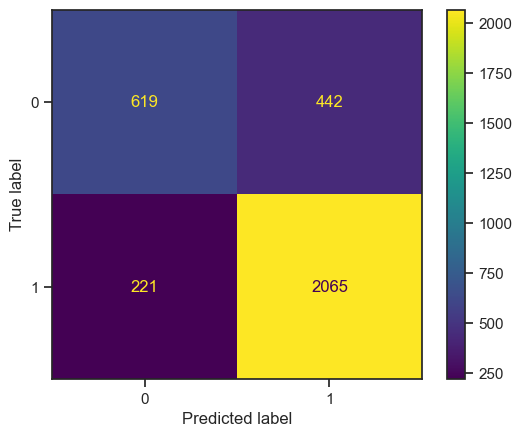

In [127]:
cm_log_gmdh = confusion_matrix(y_test, y_test_predicted, labels=forest.classes_)
display_ = ConfusionMatrixDisplay(
    confusion_matrix=cm_log_gmdh
)
display_.plot()
